In [1]:
from ultralytics import YOLO

In [2]:
from torchinfo import summary

In [3]:
from roboflow import Roboflow

In [36]:
import matplotlib.pyplot as plt
%matplotlib inline

In [26]:
import pandas as pd

In [5]:
model = YOLO("yolo11n.pt")

In [6]:
summary(model.model, input_size=(1, 3, 640, 640))

Layer (type:depth-idx)                                       Output Shape              Param #
DetectionModel                                               [1, 84, 8400]             --
├─Sequential: 1-1                                            --                        --
│    └─Conv: 2-1                                             [1, 16, 320, 320]         --
│    │    └─Conv2d: 3-1                                      [1, 16, 320, 320]         (432)
│    │    └─BatchNorm2d: 3-2                                 [1, 16, 320, 320]         (32)
│    └─Detect: 2-124                                         --                        (recursive)
│    │    └─ModuleList: 3-147                                --                        (recursive)
│    └─Conv: 2-3                                             [1, 32, 160, 160]         --
│    │    └─Conv2d: 3-4                                      [1, 32, 160, 160]         (4,608)
│    │    └─BatchNorm2d: 3-5                                 [1, 32

In [9]:
dataset_dir = '/ultralytics/examples/Work_dir/emergency-nonemergency-vehicle-7/data.yaml'

In [10]:
results = model.train(data=dataset_dir, epochs=10, imgsz=640)

Ultralytics 8.3.64 🚀 Python-3.11.10 torch-2.5.1+cpu CPU (AMD Ryzen 5 3600 6-Core Processor)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/ultralytics/examples/Work_dir/emergency-nonemergency-vehicle-7/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, sav

E0000 00:00:1737362608.143035     451 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1737362608.223161     451 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /ultralytics/examples/Work_dir/emergency-nonemergency-vehicle-7/train/labels... 2598 images, 3 backgrounds, 0 corrupt: 100%|██████████| 2598/2598 [00:05<00:00, 501.45it/s]


train: New cache created: /ultralytics/examples/Work_dir/emergency-nonemergency-vehicle-7/train/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 15, len(boxes) = 4295. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Scanning /ultralytics/examples/Work_dir/emergency-nonemergency-vehicle-7/valid/labels... 44 images, 0 backgrounds, 0 corrupt: 100%|██████████| 44/44 [00:00<00:00, 570.91it/s]

val: New cache created: /ultralytics/examples/Work_dir/emergency-nonemergency-vehicle-7/valid/labels.cache


Plotting labels to /data/runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /data/runs/detect/train3
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.004      2.341       1.59          9        640: 100%|██████████| 163/163 [1:22:57<00:00, 30.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:09<00:00,  4.86s/it]

                   all         44         70      0.693      0.576      0.581      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      1.029      1.615      1.632         13        640: 100%|██████████| 163/163 [1:16:31<00:00, 28.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.93s/it]

                   all         44         70       0.23      0.491      0.269      0.165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.017      1.329      1.624          8        640: 100%|██████████| 163/163 [14:42<00:00,  5.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.52s/it]

                   all         44         70      0.616       0.59      0.595       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.9622      1.159      1.578         17        640: 100%|██████████| 163/163 [14:23<00:00,  5.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         44         70       0.66      0.585      0.622      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.9243      1.036      1.544          9        640: 100%|██████████| 163/163 [11:46<00:00,  4.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.73s/it]

                   all         44         70      0.692      0.595      0.673      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G      0.875     0.9322      1.493          9        640: 100%|██████████| 163/163 [09:26<00:00,  3.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.68s/it]

                   all         44         70      0.862      0.664      0.739      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G      0.857     0.8592      1.472          7        640: 100%|██████████| 163/163 [09:47<00:00,  3.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.71s/it]

                   all         44         70       0.75      0.818      0.806      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.7921     0.7798      1.407          9        640: 100%|██████████| 163/163 [09:42<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.97s/it]

                   all         44         70      0.828      0.816      0.858      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G     0.7631     0.7092      1.373          7        640: 100%|██████████| 163/163 [08:56<00:00,  3.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.56s/it]

                   all         44         70      0.854      0.781      0.869      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.7203     0.6628      1.336          7        640: 100%|██████████| 163/163 [09:13<00:00,  3.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.77s/it]

                   all         44         70      0.822      0.783      0.843      0.644



10 epochs completed in 4.158 hours.
Optimizer stripped from /data/runs/detect/train3/weights/last.pt, 5.5MB
Optimizer stripped from /data/runs/detect/train3/weights/best.pt, 5.5MB

Validating /data/runs/detect/train3/weights/best.pt...
Ultralytics 8.3.64 🚀 Python-3.11.10 torch-2.5.1+cpu CPU (AMD Ryzen 5 3600 6-Core Processor)
YOLO11n summary (fused): 238 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.73s/it]


                   all         44         70      0.819      0.786      0.843      0.642
             emergency         14         18      0.762      0.889      0.878      0.689
         non-emergency         31         52      0.876      0.683      0.808      0.596
Speed: 1.6ms preprocess, 71.9ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to /data/runs/detect/train3


In [15]:
results

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f53ac7c5050>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

In [25]:
csv_path = '/data/runs/detect/train3/results.csv'

In [27]:
data = pd.read_csv(csv_path)

In [28]:
print("Available columns:", data.columns)

Available columns: Index(['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
       'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)',
       'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
       'lr/pg0', 'lr/pg1', 'lr/pg2'],
      dtype='object')


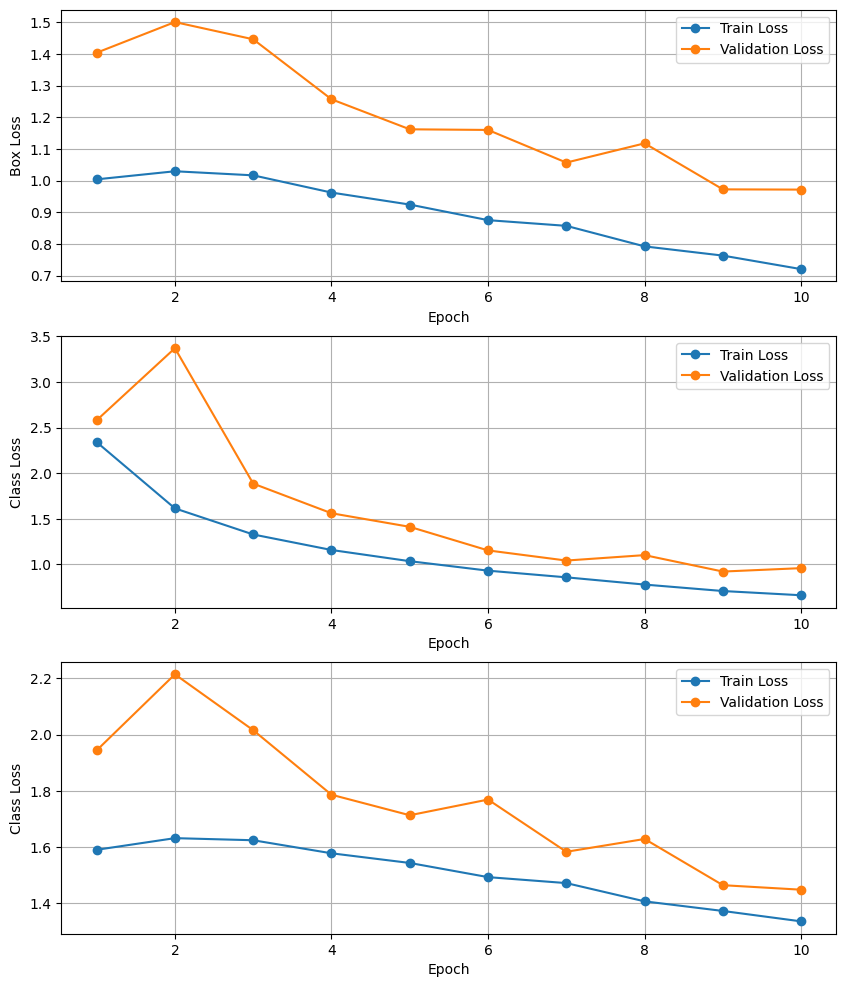

In [48]:
plt.figure(figsize=(10, 12))

plt.subplot(311)
plt.plot(data['epoch'], data['train/box_loss'], label='Train Loss', marker='o')
plt.plot(data['epoch'], data['val/box_loss'], label='Validation Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Box Loss')
plt.legend()
plt.grid()

plt.subplot(312)
plt.plot(data['epoch'], data['train/cls_loss'], label='Train Loss', marker='o')
plt.plot(data['epoch'], data['val/cls_loss'], label='Validation Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Class Loss')
plt.legend()
plt.grid()

plt.subplot(313)
plt.plot(data['epoch'], data['train/dfl_loss'], label='Train Loss', marker='o')
plt.plot(data['epoch'], data['val/dfl_loss'], label='Validation Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Class Loss')
plt.legend()
plt.grid()
plt.show()

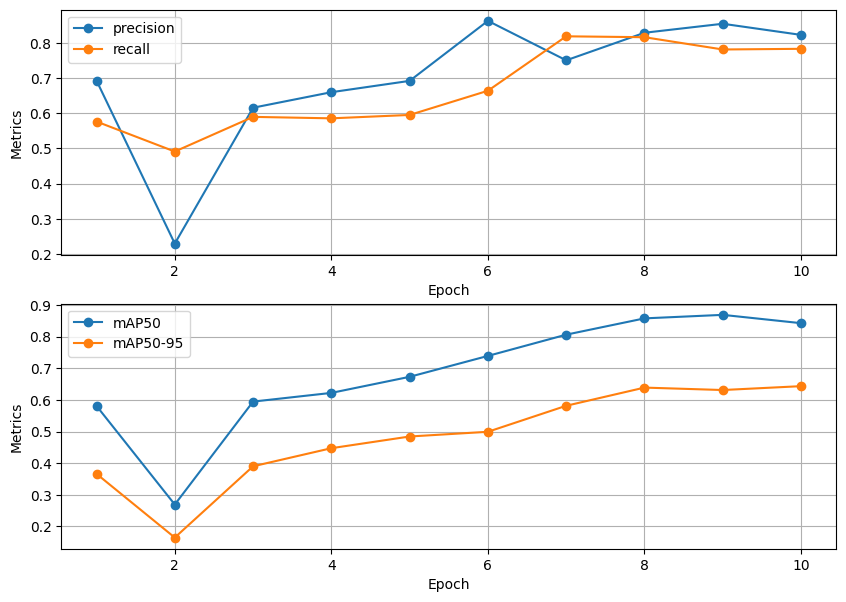

In [54]:
plt.figure(figsize=(10, 7))

plt.subplot(211)
plt.plot(data['epoch'], data['metrics/precision(B)'], label='precision', marker='o')
plt.plot(data['epoch'], data['metrics/recall(B)'], label='recall', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Metrics')
plt.legend()
plt.grid()

plt.subplot(212)
plt.plot(data['epoch'], data['metrics/mAP50(B)'], label='mAP50', marker='o')
plt.plot(data['epoch'], data['metrics/mAP50-95(B)'], label='mAP50-95', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Metrics')
plt.legend()
plt.grid()
plt.show()


image 1/1 /ultralytics/examples/Work_dir/for_test/korea.jpg: 448x640 3 emergencys, 4 non-emergencys, 78.9ms
Speed: 2.5ms preprocess, 78.9ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)


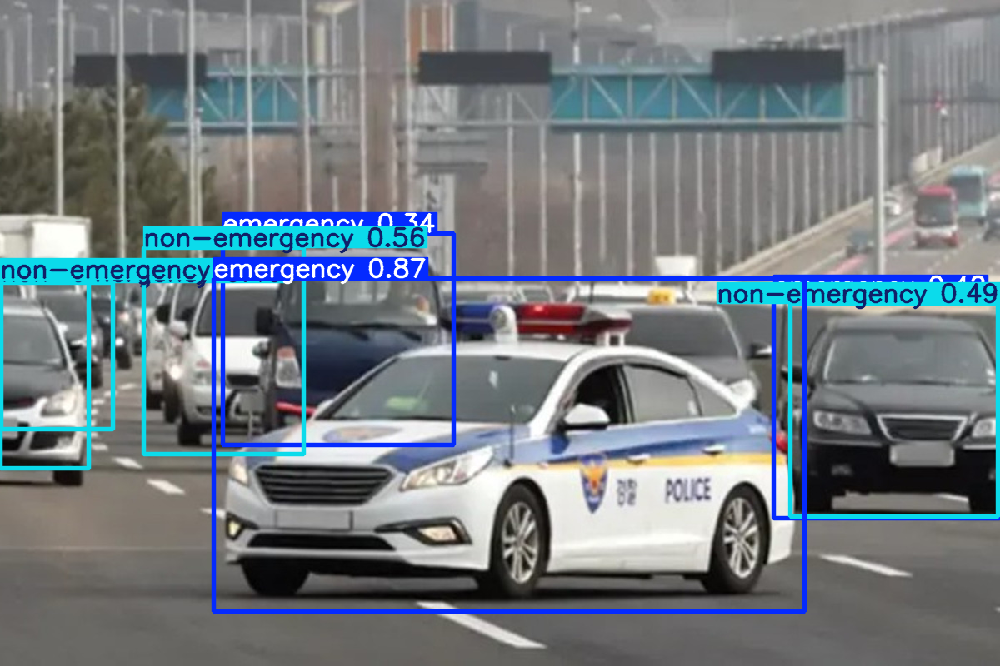

In [58]:
test1 = model("for_test/korea.jpg")
test1[0].show()


image 1/1 /ultralytics/examples/Work_dir/for_test/colorado.jpg: 384x640 2 emergencys, 2 non-emergencys, 83.3ms
Speed: 8.0ms preprocess, 83.3ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


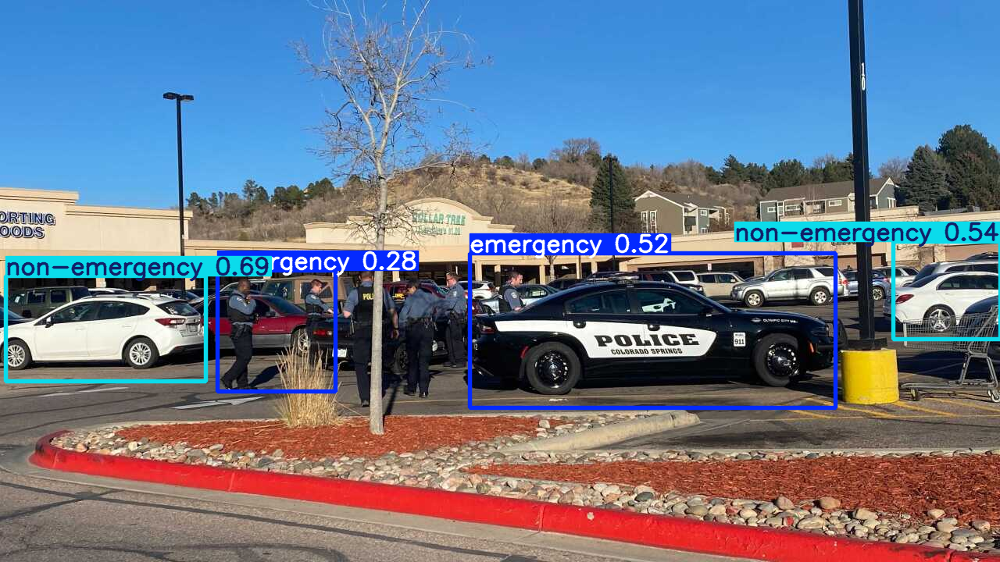

In [59]:
test2 = model("for_test/colorado.jpg")
test2[0].show()


image 1/1 /ultralytics/examples/Work_dir/for_test/california.jpg: 480x640 1 emergency, 18 non-emergencys, 78.1ms
Speed: 3.9ms preprocess, 78.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


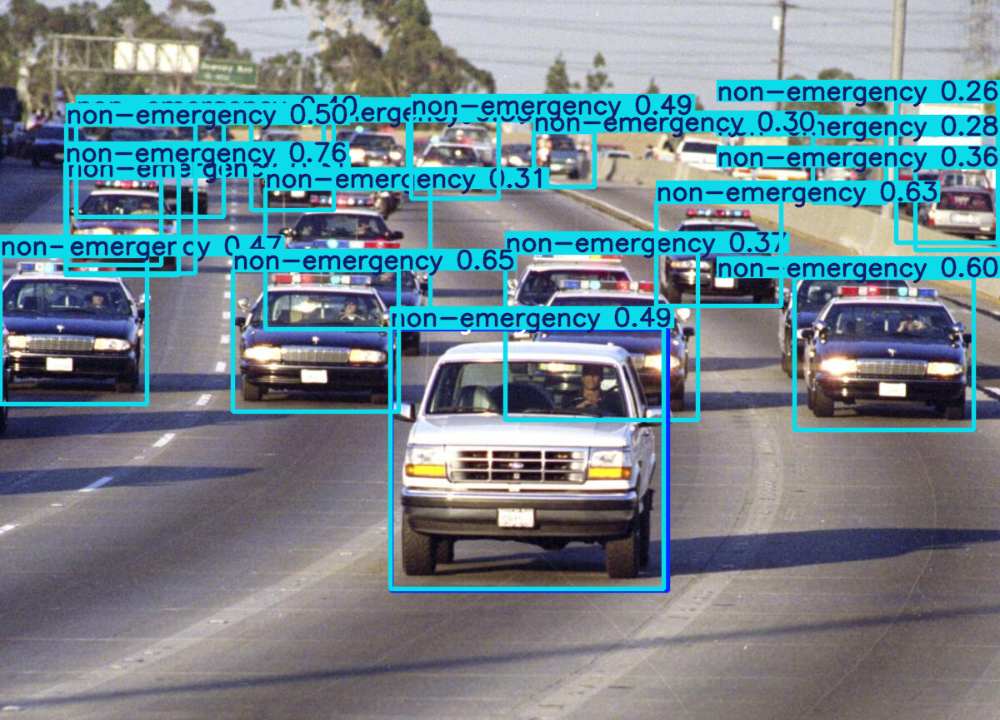

In [62]:
test3 = model("for_test/california.jpg")
test3[0].show()


image 1/1 /ultralytics/examples/Work_dir/for_test/japan.jpg: 448x640 4 emergencys, 2 non-emergencys, 57.2ms
Speed: 2.3ms preprocess, 57.2ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


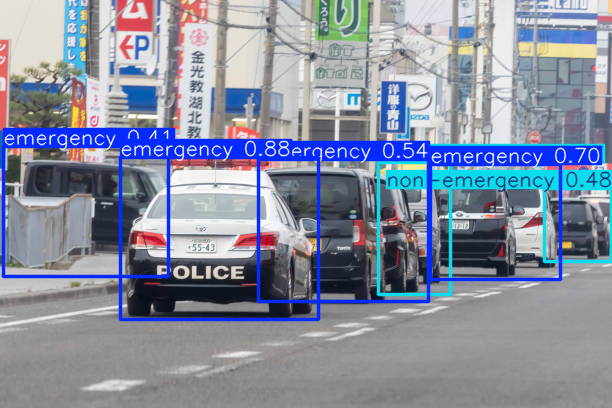

In [63]:
test4 = model("for_test/japan.jpg")
test4[0].show()


image 1/1 /ultralytics/examples/Work_dir/for_test/korea1.jpg: 384x640 1 emergency, 38 non-emergencys, 61.2ms
Speed: 1.4ms preprocess, 61.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


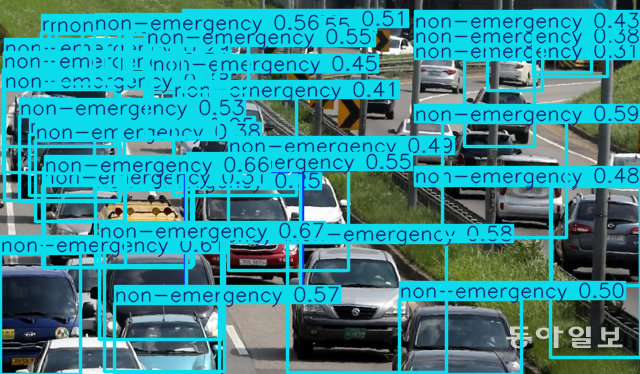

In [68]:
test8 = model("for_test/korea1.jpg")
test8[0].show()


image 1/1 /ultralytics/examples/Work_dir/for_test/colorado1.jpg: 512x640 3 emergencys, 3 non-emergencys, 59.9ms
Speed: 2.3ms preprocess, 59.9ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)


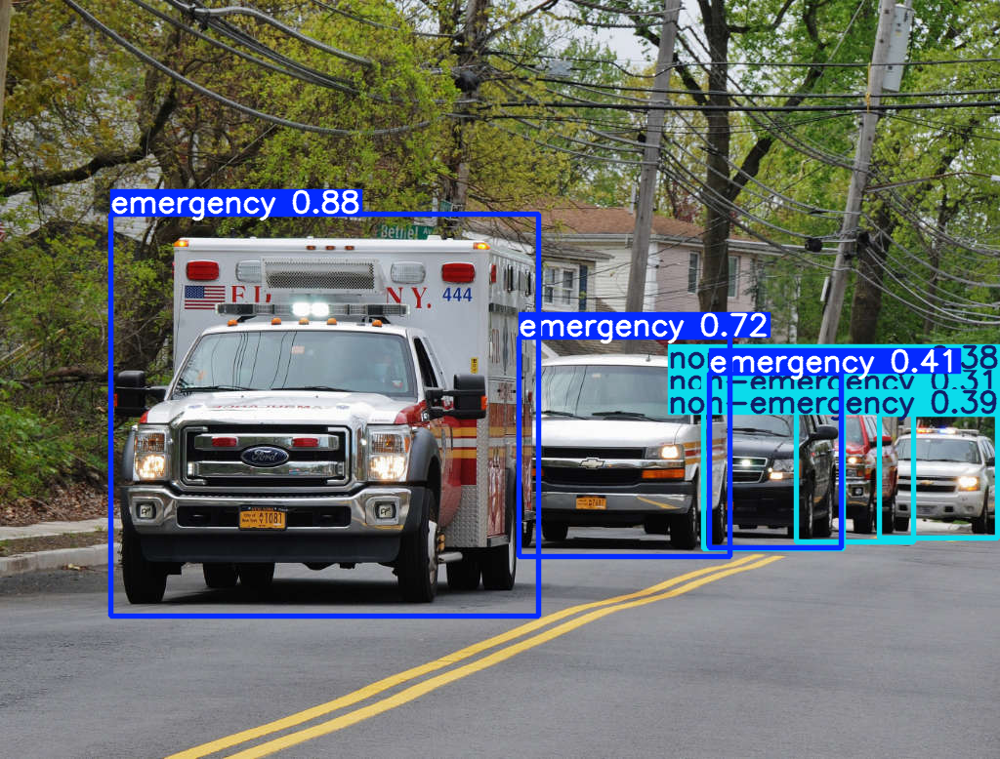

In [65]:
test5 = model("for_test/colorado1.jpg")
test5[0].show()


image 1/1 /ultralytics/examples/Work_dir/for_test/california1.jpg: 512x640 2 emergencys, 5 non-emergencys, 77.3ms
Speed: 2.4ms preprocess, 77.3ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)


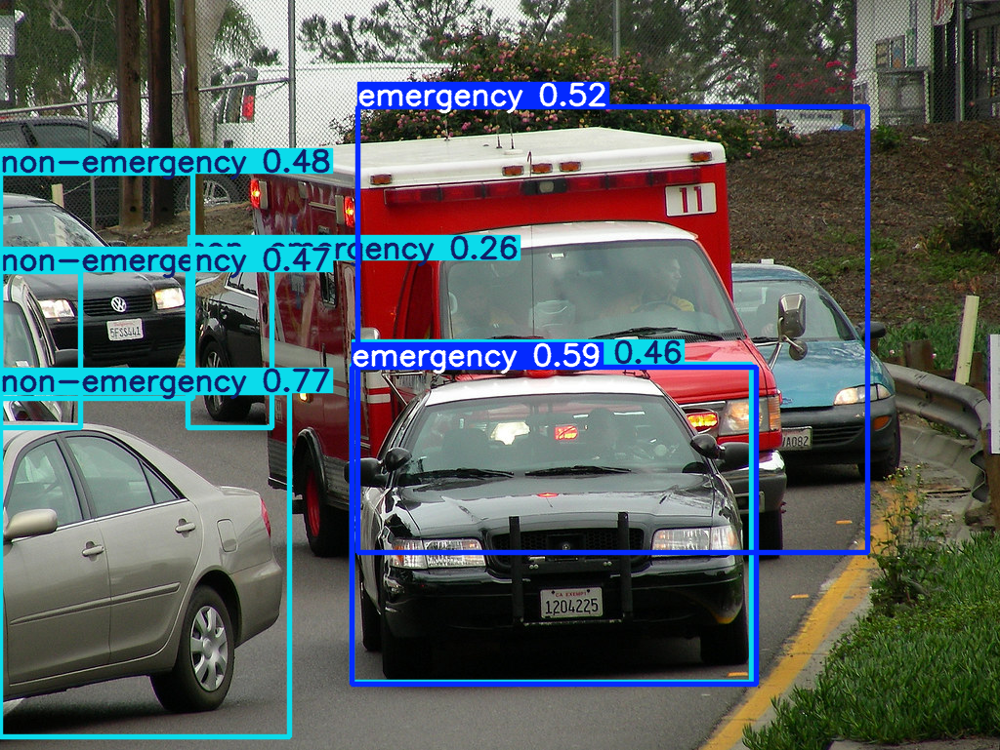

In [66]:
test6 = model("for_test/california1.jpg")
test6[0].show()


image 1/1 /ultralytics/examples/Work_dir/for_test/japan1.jpg: 640x640 15 non-emergencys, 162.6ms
Speed: 6.9ms preprocess, 162.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


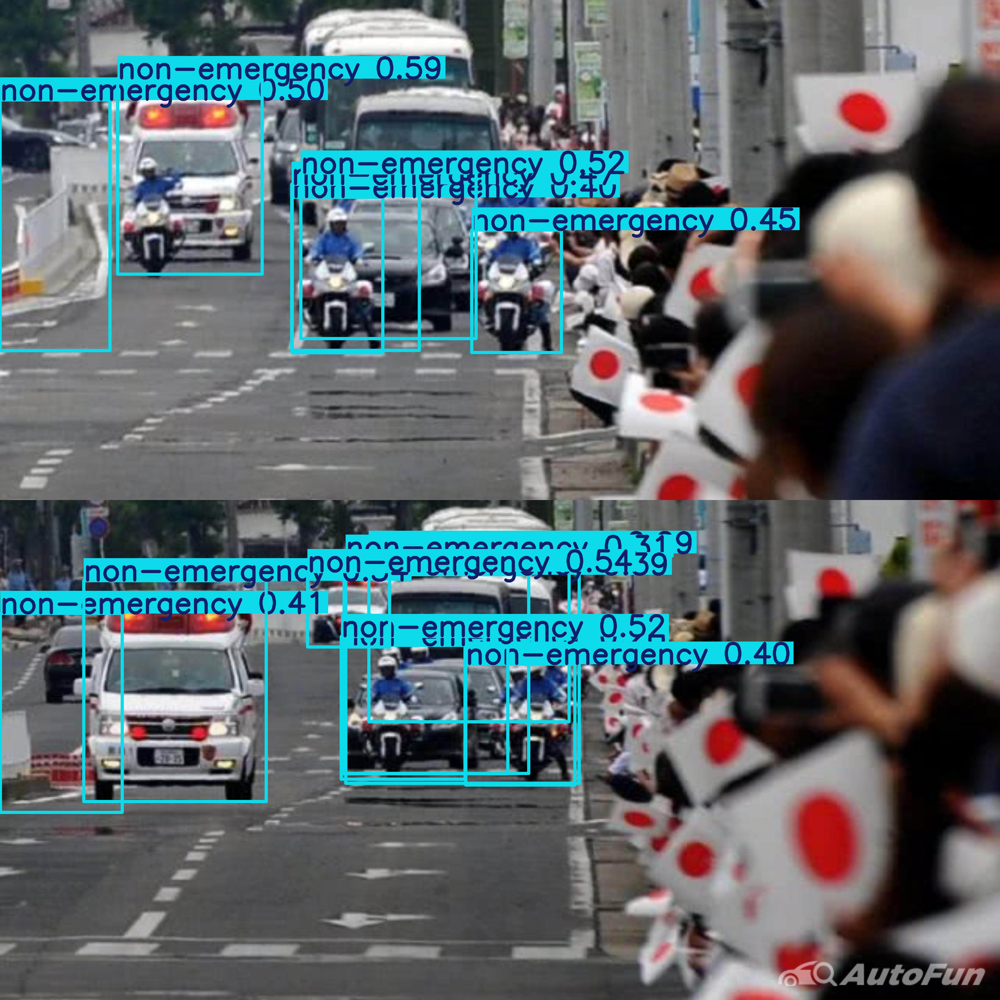

In [67]:
test7 = model("for_test/japan1.jpg")
test7[0].show()